# 요약
### 데이터 탐색

사용한 데이터 서울시 교통사고 데이터 (2015~2010) 6년치 이용

- 데이터 컬럼 : 사고번호
- 사고번호, 사고일시, 요일, 시군구, 사고내용, 사망자수, 중상자수, 경상자수, 부상신고자수,
사고유형, 법규위반, 노면상태, 기상상태, 도로형태, 가해운전자 차종, 가해운전자 성별,
가해운전자 연령, 가해운전자 상해정도, 피해운전자 차종, 피해운전자 성별, 피해운전자 연령,
피해운전자 상해정도, 발생연도, 발생월, 발생일자, 발생시간, 사고건수
- 예측하고자한 값 : 서울 시내에서, 특정 시간대에 발생할 교통사고 건수 예측

### 데이터 전처리

1. 사고 일시를 datatime의 형태로 변경
2. 사고일시를 발생연도, 발생월, 발생일, 발생시간으로 나눔
3. 학습을 위한 데이터 셋을 재구성함
    1. 사고 일시 기준으로 groupby하여 새로운 데이터 프레임생성
    2. 필요 컬럼만 사용하였고, 사고 일시 당시의 최빈값으로 입력함.
    - 사용컬럼 :
4. 범주형 특성 라벨링
   - ['노면상태', '기상상태', '도로형태', '요일'] 를 숫자로 라벨링( 범주가 많아 one-hot encoding 방식을 사용하지 않고, label encoding 방식을 사용)
5. train, test 데이터셋 분리
    - 2015\~2018까지의 데이터를 트레인 데이터셋, 2019\~2020까지의 데이터를 테스트 데이터셋으로 사용

### 모델 학습

- Randomfroest Regressor 이용
- 최초 학습 기준결과

    훈련 데이터 MSE : 0.728, 테스트 데이터 MSE : 5.552
    훈련 데이터 R^2^ : 0.895, 테스트 데이터 R^2^ : 0.276

- GridSearchCV로 하이퍼파라미터 튜닝 후 학습결과

    훈련 데이터 MSE : 4.455, 테스트 데이터 MSE : 4.983
    훈련 데이터 R^2^ : 0.370, 테스트 데이터 R^2^ : 0.350

In [1]:
import pandas as pd
import numpy as np


# 머신러닝 : 교통사고 발생 건수 예측
- 발생 월, 요일, 지역 정보를 이용하여 사고 건수 예측
- 새로운 버전에서는 점수 올리기 위해 데이터 수를 늘려보기 시도 및 경우의 수에 따라 다양한 피쳐 넣어보ㅊ

## 데이터 불러오기 및 데이터 프레임 만들기

In [2]:
list_2015_seoul = pd.read_html('data/교통사고_서울_2015.xls')
df_2015_seoul = pd.DataFrame(list_2015_seoul[0])

In [3]:
list_2016_seoul = pd.read_html('data/교통사고_서울_2016.xls')
df_2016_seoul = pd.DataFrame(list_2016_seoul[0])

In [4]:
list_2017_seoul = pd.read_html('data/교통사고_서울_2017.xls')
df_2017_seoul = pd.DataFrame(list_2017_seoul[0])

In [5]:
list_2018_seoul = pd.read_html('data/교통사고_서울_2018.xls')
df_2018_seoul = pd.DataFrame(list_2018_seoul[0])

In [6]:
list_2019_seoul = pd.read_html('data/교통사고_서울_2019.xls')
df_2019_seoul = pd.DataFrame(list_2019_seoul[0])

In [7]:
list_2020_seoul = pd.read_html('data/교통사고_서울_2020.xls')
df_2020_seoul = pd.DataFrame(list_2020_seoul[0])
# 2021년 데이터는 노면상태가 없어 사용하지 않음

In [8]:
df_2019_seoul

,사고번호,사고일시,요일,시군구,사고내용,사망자수,중상자수,경상자수,부상신고자수,사고유형,...,기상상태,도로형태,가해운전자 차종,가해운전자 성별,가해운전자 연령,가해운전자 상해정도,피해운전자 차종,피해운전자 성별,피해운전자 연령,피해운전자 상해정도
0,2019010100100001,2019년 1월 1일 00시,화요일,서울특별시 강서구 방화동,경상사고,0,0,1,0,차대사람 - 횡단중,...,맑음,교차로 - 교차로횡단보도내,승용,남,26세,상해없음,보행자,남,40세,경상
1,2019010100100002,2019년 1월 1일 00시,화요일,서울특별시 구로구 고척동,경상사고,0,0,1,0,차대차 - 추돌,...,맑음,단일로 - 기타,이륜,남,23세,상해없음,승용,남,71세,경상
2,2019010100100003,2019년 1월 1일 00시,화요일,서울특별시 서초구 서초동,경상사고,0,0,1,0,차대차 - 기타,...,맑음,기타 - 기타,승용,남,33세,상해없음,화물,남,51세,경상
3,2019010100100019,2019년 1월 1일 01시,화요일,서울특별시 중구 회현동2가,경상사고,0,0,1,0,차대차 - 측면충돌,...,맑음,단일로 - 터널,승용,남,58세,상해없음,승용,남,62세,경상
4,2019010100100020,2019년 1월 1일 01시,화요일,서울특별시 성동구 행당동,경상사고,0,0,1,0,차대사람 - 횡단중,...,맑음,교차로 - 교차로부근,승용,남,30세,상해없음,보행자,남,32세,경상
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39253,2019123100100610,2019년 12월 31일 22시,화요일,서울특별시 중랑구 면목동,부상신고사고,0,0,0,1,차대사람 - 차도통행중,...,맑음,단일로 - 기타,화물,남,28세,상해없음,보행자,여,33세,부상신고
39254,2019123100100611,2019년 12월 31일 22시,화요일,서울특별시 강남구 삼성동,경상사고,0,0,1,0,차대차 - 기타,...,맑음,단일로 - 기타,승용,여,41세,상해없음,승용,여,61세,경상
39255,2019123100100612,2019년 12월 31일 22시,화요일,서울특별시 송파구 송파동,경상사고,0,0,1,0,차대사람 - 횡단중,...,맑음,교차로 - 교차로부근,승용,남,36세,상해없음,보행자,여,18세,경상
39256,2019123100100634,2019년 12월 31일 23시,화요일,서울특별시 강남구 역삼동,부상신고사고,0,0,0,2,차량단독 - 기타,...,맑음,단일로 - 기타,승용,남,59세,상해없음,NaN,NaN,NaN,NaN


In [9]:
# 6개 DataFrame concat 하기
df_seoul = pd.concat([df_2015_seoul, df_2016_seoul, df_2017_seoul, df_2018_seoul, df_2019_seoul, df_2020_seoul])

In [10]:
df_seoul.reset_index(drop=True)

,사고번호,사고일시,요일,시군구,사고내용,사망자수,중상자수,경상자수,부상신고자수,사고유형,...,기상상태,도로형태,가해운전자 차종,가해운전자 성별,가해운전자 연령,가해운전자 상해정도,피해운전자 차종,피해운전자 성별,피해운전자 연령,피해운전자 상해정도
0,2015010100100001,2015년 1월 1일 00시,목요일,서울특별시 은평구 응암동,중상사고,0,1,0,0,차대사람 - 길가장자리구역통행중,...,맑음,교차로 - 교차로안,승용,남,27세,상해없음,보행자,남,48세,중상
1,2015010100100002,2015년 1월 1일 00시,목요일,서울특별시 은평구 신사동,중상사고,0,1,0,0,차대사람 - 보도통행중,...,맑음,단일로 - 기타,승용,남,60세,상해없음,보행자,남,59세,중상
2,2015010100100003,2015년 1월 1일 00시,목요일,서울특별시 동대문구 휘경동,중상사고,0,1,0,0,차대사람 - 기타,...,맑음,교차로 - 교차로부근,승용,남,66세,상해없음,보행자,남,52세,중상
3,2015010100100004,2015년 1월 1일 00시,목요일,서울특별시 송파구 잠실동,경상사고,0,0,1,0,차대차 - 추돌 - 진행중,...,맑음,단일로 - 기타,승용,남,52세,상해없음,승용,여,57세,경상
4,2015010100100039,2015년 1월 1일 01시,목요일,서울특별시 중구 쌍림동,경상사고,0,0,1,0,차대차 - 측면직각충돌,...,맑음,단일로 - 기타,승용,남,62세,상해없음,승용,남,62세,상해없음
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
233604,2020123100100571,2020년 12월 31일 22시,목요일,서울특별시 동대문구 제기동,경상사고,0,0,1,0,차대차 - 기타,...,맑음,단일로 - 기타,화물,남,35세,상해없음,자전거,남,41세,경상
233605,2020123100100572,2020년 12월 31일 22시,목요일,서울특별시 강동구 강일동,경상사고,0,0,1,0,차대차 - 정면충돌,...,흐림,교차로 - 교차로부근,승용,남,61세,상해없음,승용,남,21세,경상
233606,2020123100100591,2020년 12월 31일 23시,목요일,서울특별시 강남구 삼성동,경상사고,0,0,2,0,차대차 - 추돌,...,맑음,교차로 - 교차로안,승용,남,55세,기타불명,승용,남,29세,경상
233607,2020123100100592,2020년 12월 31일 23시,목요일,서울특별시 송파구 신천동,중상사고,0,1,0,0,차대차 - 측면충돌,...,맑음,단일로 - 기타,승용,남,62세,상해없음,이륜,남,22세,중상


## 데이터 피쳐 탐색

In [11]:
df_seoul.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 233609 entries, 0 to 35226
Data columns (total 22 columns):
 #   Column      Non-Null Count   Dtype 
---  ------      --------------   ----- 
 0   사고번호        233609 non-null  int64 
 1   사고일시        233609 non-null  object
 2   요일          233609 non-null  object
 3   시군구         233609 non-null  object
 4   사고내용        233609 non-null  object
 5   사망자수        233609 non-null  int64 
 6   중상자수        233609 non-null  int64 
 7   경상자수        233609 non-null  int64 
 8   부상신고자수      233609 non-null  int64 
 9   사고유형        233609 non-null  object
 10  법규위반        233609 non-null  object
 11  노면상태        233609 non-null  object
 12  기상상태        233609 non-null  object
 13  도로형태        233609 non-null  object
 14  가해운전자 차종    233609 non-null  object
 15  가해운전자 성별    233609 non-null  object
 16  가해운전자 연령    233609 non-null  object
 17  가해운전자 상해정도  233609 non-null  object
 18  피해운전자 차종    226164 non-null  object
 19  피해운전자 성별    226164 non-n

In [12]:
df_seoul

,사고번호,사고일시,요일,시군구,사고내용,사망자수,중상자수,경상자수,부상신고자수,사고유형,...,기상상태,도로형태,가해운전자 차종,가해운전자 성별,가해운전자 연령,가해운전자 상해정도,피해운전자 차종,피해운전자 성별,피해운전자 연령,피해운전자 상해정도
0,2015010100100001,2015년 1월 1일 00시,목요일,서울특별시 은평구 응암동,중상사고,0,1,0,0,차대사람 - 길가장자리구역통행중,...,맑음,교차로 - 교차로안,승용,남,27세,상해없음,보행자,남,48세,중상
1,2015010100100002,2015년 1월 1일 00시,목요일,서울특별시 은평구 신사동,중상사고,0,1,0,0,차대사람 - 보도통행중,...,맑음,단일로 - 기타,승용,남,60세,상해없음,보행자,남,59세,중상
2,2015010100100003,2015년 1월 1일 00시,목요일,서울특별시 동대문구 휘경동,중상사고,0,1,0,0,차대사람 - 기타,...,맑음,교차로 - 교차로부근,승용,남,66세,상해없음,보행자,남,52세,중상
3,2015010100100004,2015년 1월 1일 00시,목요일,서울특별시 송파구 잠실동,경상사고,0,0,1,0,차대차 - 추돌 - 진행중,...,맑음,단일로 - 기타,승용,남,52세,상해없음,승용,여,57세,경상
4,2015010100100039,2015년 1월 1일 01시,목요일,서울특별시 중구 쌍림동,경상사고,0,0,1,0,차대차 - 측면직각충돌,...,맑음,단일로 - 기타,승용,남,62세,상해없음,승용,남,62세,상해없음
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
35222,2020123100100571,2020년 12월 31일 22시,목요일,서울특별시 동대문구 제기동,경상사고,0,0,1,0,차대차 - 기타,...,맑음,단일로 - 기타,화물,남,35세,상해없음,자전거,남,41세,경상
35223,2020123100100572,2020년 12월 31일 22시,목요일,서울특별시 강동구 강일동,경상사고,0,0,1,0,차대차 - 정면충돌,...,흐림,교차로 - 교차로부근,승용,남,61세,상해없음,승용,남,21세,경상
35224,2020123100100591,2020년 12월 31일 23시,목요일,서울특별시 강남구 삼성동,경상사고,0,0,2,0,차대차 - 추돌,...,맑음,교차로 - 교차로안,승용,남,55세,기타불명,승용,남,29세,경상
35225,2020123100100592,2020년 12월 31일 23시,목요일,서울특별시 송파구 신천동,중상사고,0,1,0,0,차대차 - 측면충돌,...,맑음,단일로 - 기타,승용,남,62세,상해없음,이륜,남,22세,중상


In [13]:
df_seoul.columns

Index(['사고번호', '사고일시', '요일', '시군구', '사고내용', '사망자수', '중상자수', '경상자수', '부상신고자수',
       '사고유형', '법규위반', '노면상태', '기상상태', '도로형태', '가해운전자 차종', '가해운전자 성별',
       '가해운전자 연령', '가해운전자 상해정도', '피해운전자 차종', '피해운전자 성별', '피해운전자 연령',
       '피해운전자 상해정도'],
      dtype='object')

In [14]:
df_seoul.isnull().sum()

사고번호             0
사고일시             0
요일               0
시군구              0
사고내용             0
사망자수             0
중상자수             0
경상자수             0
부상신고자수           0
사고유형             0
법규위반             0
노면상태             0
기상상태             0
도로형태             0
가해운전자 차종         0
가해운전자 성별         0
가해운전자 연령         0
가해운전자 상해정도       0
피해운전자 차종      7445
피해운전자 성별      7445
피해운전자 연령      7445
피해운전자 상해정도    7445
dtype: int64

In [15]:
df_seoul.groupby('요일').count()

,사고번호,사고일시,시군구,사고내용,사망자수,중상자수,경상자수,부상신고자수,사고유형,법규위반,...,기상상태,도로형태,가해운전자 차종,가해운전자 성별,가해운전자 연령,가해운전자 상해정도,피해운전자 차종,피해운전자 성별,피해운전자 연령,피해운전자 상해정도
요일,,,,,,,,,,,,,,,,,,,,,
금요일,37148,37148,37148,37148,37148,37148,37148,37148,37148,37148,...,37148,37148,37148,37148,37148,37148,36034,36034,36034,36034
목요일,34541,34541,34541,34541,34541,34541,34541,34541,34541,34541,...,34541,34541,34541,34541,34541,34541,33468,33468,33468,33468
수요일,34258,34258,34258,34258,34258,34258,34258,34258,34258,34258,...,34258,34258,34258,34258,34258,34258,33157,33157,33157,33157
월요일,32991,32991,32991,32991,32991,32991,32991,32991,32991,32991,...,32991,32991,32991,32991,32991,32991,31939,31939,31939,31939
일요일,25909,25909,25909,25909,25909,25909,25909,25909,25909,25909,...,25909,25909,25909,25909,25909,25909,24922,24922,24922,24922
토요일,34952,34952,34952,34952,34952,34952,34952,34952,34952,34952,...,34952,34952,34952,34952,34952,34952,33867,33867,33867,33867
화요일,33810,33810,33810,33810,33810,33810,33810,33810,33810,33810,...,33810,33810,33810,33810,33810,33810,32777,32777,32777,32777


In [16]:
df_seoul.groupby('노면상태').count()

,사고번호,사고일시,요일,시군구,사고내용,사망자수,중상자수,경상자수,부상신고자수,사고유형,...,기상상태,도로형태,가해운전자 차종,가해운전자 성별,가해운전자 연령,가해운전자 상해정도,피해운전자 차종,피해운전자 성별,피해운전자 연령,피해운전자 상해정도
노면상태,,,,,,,,,,,,,,,,,,,,,
비포장 - 건조,94,94,94,94,94,94,94,94,94,94,...,94,94,94,94,94,94,84,84,84,84
비포장 - 기타,40,40,40,40,40,40,40,40,40,40,...,40,40,40,40,40,40,36,36,36,36
비포장 - 서리/결빙,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
비포장 - 습기,19,19,19,19,19,19,19,19,19,19,...,19,19,19,19,19,19,18,18,18,18
비포장 - 적설,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
비포장 - 젖음/습기,53,53,53,53,53,53,53,53,53,53,...,53,53,53,53,53,53,52,52,52,52
비포장 - 해빙,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
포장 - 건조,209680,209680,209680,209680,209680,209680,209680,209680,209680,209680,...,209680,209680,209680,209680,209680,209680,203259,203259,203259,203259
포장 - 결빙,146,146,146,146,146,146,146,146,146,146,...,146,146,146,146,146,146,124,124,124,124


In [17]:
df_seoul[df_seoul['노면상태'] == '-']

,사고번호,사고일시,요일,시군구,사고내용,사망자수,중상자수,경상자수,부상신고자수,사고유형,...,기상상태,도로형태,가해운전자 차종,가해운전자 성별,가해운전자 연령,가해운전자 상해정도,피해운전자 차종,피해운전자 성별,피해운전자 연령,피해운전자 상해정도


In [18]:
df_seoul.columns

Index(['사고번호', '사고일시', '요일', '시군구', '사고내용', '사망자수', '중상자수', '경상자수', '부상신고자수',
       '사고유형', '법규위반', '노면상태', '기상상태', '도로형태', '가해운전자 차종', '가해운전자 성별',
       '가해운전자 연령', '가해운전자 상해정도', '피해운전자 차종', '피해운전자 성별', '피해운전자 연령',
       '피해운전자 상해정도'],
      dtype='object')

In [19]:
df_seoul.groupby('도로형태').count()

,사고번호,사고일시,요일,시군구,사고내용,사망자수,중상자수,경상자수,부상신고자수,사고유형,...,노면상태,기상상태,가해운전자 차종,가해운전자 성별,가해운전자 연령,가해운전자 상해정도,피해운전자 차종,피해운전자 성별,피해운전자 연령,피해운전자 상해정도
도로형태,,,,,,,,,,,,,,,,,,,,,
교차로 - 교차로부근,35724,35724,35724,35724,35724,35724,35724,35724,35724,35724,...,35724,35724,35724,35724,35724,35724,34847,34847,34847,34847
교차로 - 교차로안,55407,55407,55407,55407,55407,55407,55407,55407,55407,55407,...,55407,55407,55407,55407,55407,55407,54792,54792,54792,54792
교차로 - 교차로횡단보도내,5668,5668,5668,5668,5668,5668,5668,5668,5668,5668,...,5668,5668,5668,5668,5668,5668,5654,5654,5654,5654
기타 - 기타,9540,9540,9540,9540,9540,9540,9540,9540,9540,9540,...,9540,9540,9540,9540,9540,9540,9192,9192,9192,9192
단일로 - 고가도로위,594,594,594,594,594,594,594,594,594,594,...,594,594,594,594,594,594,546,546,546,546
단일로 - 교량,1942,1942,1942,1942,1942,1942,1942,1942,1942,1942,...,1942,1942,1942,1942,1942,1942,1836,1836,1836,1836
단일로 - 기타,117490,117490,117490,117490,117490,117490,117490,117490,117490,117490,...,117490,117490,117490,117490,117490,117490,112290,112290,112290,112290
단일로 - 지하차도(도로)내,1179,1179,1179,1179,1179,1179,1179,1179,1179,1179,...,1179,1179,1179,1179,1179,1179,1109,1109,1109,1109
단일로 - 터널,722,722,722,722,722,722,722,722,722,722,...,722,722,722,722,722,722,650,650,650,650


In [20]:
df_seoul.groupby('기상상태').count()

,사고번호,사고일시,요일,시군구,사고내용,사망자수,중상자수,경상자수,부상신고자수,사고유형,...,노면상태,도로형태,가해운전자 차종,가해운전자 성별,가해운전자 연령,가해운전자 상해정도,피해운전자 차종,피해운전자 성별,피해운전자 연령,피해운전자 상해정도
기상상태,,,,,,,,,,,,,,,,,,,,,
기타,2285,2285,2285,2285,2285,2285,2285,2285,2285,2285,...,2285,2285,2285,2285,2285,2285,2208,2208,2208,2208
눈,787,787,787,787,787,787,787,787,787,787,...,787,787,787,787,787,787,750,750,750,750
맑음,206387,206387,206387,206387,206387,206387,206387,206387,206387,206387,...,206387,206387,206387,206387,206387,206387,199968,199968,199968,199968
비,14629,14629,14629,14629,14629,14629,14629,14629,14629,14629,...,14629,14629,14629,14629,14629,14629,14039,14039,14039,14039
안개,27,27,27,27,27,27,27,27,27,27,...,27,27,27,27,27,27,24,24,24,24
흐림,9494,9494,9494,9494,9494,9494,9494,9494,9494,9494,...,9494,9494,9494,9494,9494,9494,9175,9175,9175,9175


In [21]:
# 판다스 지수표현 옵션
#pd.options.display.float_format = '{:.0f}'.format
#pd.reset_option('display.float_format')

In [22]:
df_seoul.reset_index(drop=True, inplace=True)

# 데이터 전처리
1. 사고일시를 datetime 형태로 변경할 것.
2. 범주형 데이터들의 인코딩
3. 시군구 컬림에서 동을 제외하고 구까지만 사용하기
    - 해당 시군구에서 발생하는 사고 건수를 예측하는 것.
4. y값을... 무엇으로?

### 사고 일시를 date time 객체로 변환시키기

In [23]:
# pd.to_datetime 함수 사용
format = '%Y년 %m월 %d일 %H시'
df_seoul['사고일시'] = pd.to_datetime(df_seoul['사고일시'], format=format)

## 발생지 시군구를 구 단위 까지만 남기기

In [24]:
df_seoul

,사고번호,사고일시,요일,시군구,사고내용,사망자수,중상자수,경상자수,부상신고자수,사고유형,...,기상상태,도로형태,가해운전자 차종,가해운전자 성별,가해운전자 연령,가해운전자 상해정도,피해운전자 차종,피해운전자 성별,피해운전자 연령,피해운전자 상해정도
0,2015010100100001,2015-01-01 00:00:00,목요일,서울특별시 은평구 응암동,중상사고,0,1,0,0,차대사람 - 길가장자리구역통행중,...,맑음,교차로 - 교차로안,승용,남,27세,상해없음,보행자,남,48세,중상
1,2015010100100002,2015-01-01 00:00:00,목요일,서울특별시 은평구 신사동,중상사고,0,1,0,0,차대사람 - 보도통행중,...,맑음,단일로 - 기타,승용,남,60세,상해없음,보행자,남,59세,중상
2,2015010100100003,2015-01-01 00:00:00,목요일,서울특별시 동대문구 휘경동,중상사고,0,1,0,0,차대사람 - 기타,...,맑음,교차로 - 교차로부근,승용,남,66세,상해없음,보행자,남,52세,중상
3,2015010100100004,2015-01-01 00:00:00,목요일,서울특별시 송파구 잠실동,경상사고,0,0,1,0,차대차 - 추돌 - 진행중,...,맑음,단일로 - 기타,승용,남,52세,상해없음,승용,여,57세,경상
4,2015010100100039,2015-01-01 01:00:00,목요일,서울특별시 중구 쌍림동,경상사고,0,0,1,0,차대차 - 측면직각충돌,...,맑음,단일로 - 기타,승용,남,62세,상해없음,승용,남,62세,상해없음
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
233604,2020123100100571,2020-12-31 22:00:00,목요일,서울특별시 동대문구 제기동,경상사고,0,0,1,0,차대차 - 기타,...,맑음,단일로 - 기타,화물,남,35세,상해없음,자전거,남,41세,경상
233605,2020123100100572,2020-12-31 22:00:00,목요일,서울특별시 강동구 강일동,경상사고,0,0,1,0,차대차 - 정면충돌,...,흐림,교차로 - 교차로부근,승용,남,61세,상해없음,승용,남,21세,경상
233606,2020123100100591,2020-12-31 23:00:00,목요일,서울특별시 강남구 삼성동,경상사고,0,0,2,0,차대차 - 추돌,...,맑음,교차로 - 교차로안,승용,남,55세,기타불명,승용,남,29세,경상
233607,2020123100100592,2020-12-31 23:00:00,목요일,서울특별시 송파구 신천동,중상사고,0,1,0,0,차대차 - 측면충돌,...,맑음,단일로 - 기타,승용,남,62세,상해없음,이륜,남,22세,중상


In [25]:
def remain_gu(str):
    remain_list = str.split(' ')
    result = remain_list[-2]
    return result

In [26]:
df_seoul['시군구'] = df_seoul['시군구'].apply(remain_gu)

In [27]:
df_seoul

,사고번호,사고일시,요일,시군구,사고내용,사망자수,중상자수,경상자수,부상신고자수,사고유형,...,기상상태,도로형태,가해운전자 차종,가해운전자 성별,가해운전자 연령,가해운전자 상해정도,피해운전자 차종,피해운전자 성별,피해운전자 연령,피해운전자 상해정도
0,2015010100100001,2015-01-01 00:00:00,목요일,은평구,중상사고,0,1,0,0,차대사람 - 길가장자리구역통행중,...,맑음,교차로 - 교차로안,승용,남,27세,상해없음,보행자,남,48세,중상
1,2015010100100002,2015-01-01 00:00:00,목요일,은평구,중상사고,0,1,0,0,차대사람 - 보도통행중,...,맑음,단일로 - 기타,승용,남,60세,상해없음,보행자,남,59세,중상
2,2015010100100003,2015-01-01 00:00:00,목요일,동대문구,중상사고,0,1,0,0,차대사람 - 기타,...,맑음,교차로 - 교차로부근,승용,남,66세,상해없음,보행자,남,52세,중상
3,2015010100100004,2015-01-01 00:00:00,목요일,송파구,경상사고,0,0,1,0,차대차 - 추돌 - 진행중,...,맑음,단일로 - 기타,승용,남,52세,상해없음,승용,여,57세,경상
4,2015010100100039,2015-01-01 01:00:00,목요일,중구,경상사고,0,0,1,0,차대차 - 측면직각충돌,...,맑음,단일로 - 기타,승용,남,62세,상해없음,승용,남,62세,상해없음
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
233604,2020123100100571,2020-12-31 22:00:00,목요일,동대문구,경상사고,0,0,1,0,차대차 - 기타,...,맑음,단일로 - 기타,화물,남,35세,상해없음,자전거,남,41세,경상
233605,2020123100100572,2020-12-31 22:00:00,목요일,강동구,경상사고,0,0,1,0,차대차 - 정면충돌,...,흐림,교차로 - 교차로부근,승용,남,61세,상해없음,승용,남,21세,경상
233606,2020123100100591,2020-12-31 23:00:00,목요일,강남구,경상사고,0,0,2,0,차대차 - 추돌,...,맑음,교차로 - 교차로안,승용,남,55세,기타불명,승용,남,29세,경상
233607,2020123100100592,2020-12-31 23:00:00,목요일,송파구,중상사고,0,1,0,0,차대차 - 측면충돌,...,맑음,단일로 - 기타,승용,남,62세,상해없음,이륜,남,22세,중상


### 사고 일시 쪼개기
- 발생연도, 발생월, 발생 시간을 피쳐로 사용하기 위해 사고 일시를 쪼갬

In [28]:
df_seoul['발생연도'] = df_seoul['사고일시'].dt.year
df_seoul['발생월'] = df_seoul['사고일시'].dt.month
df_seoul['발생일자'] = df_seoul['사고일시'].dt.day
df_seoul['발생시간'] = df_seoul['사고일시'].dt.hour

In [29]:
df_seoul.groupby(['발생시간']).count()

,사고번호,사고일시,요일,시군구,사고내용,사망자수,중상자수,경상자수,부상신고자수,사고유형,...,가해운전자 성별,가해운전자 연령,가해운전자 상해정도,피해운전자 차종,피해운전자 성별,피해운전자 연령,피해운전자 상해정도,발생연도,발생월,발생일자
발생시간,,,,,,,,,,,,,,,,,,,,,
0,8636,8636,8636,8636,8636,8636,8636,8636,8636,8636,...,8636,8636,8636,8286,8286,8286,8286,8636,8636,8636
1,7107,7107,7107,7107,7107,7107,7107,7107,7107,7107,...,7107,7107,7107,6764,6764,6764,6764,7107,7107,7107
2,5480,5480,5480,5480,5480,5480,5480,5480,5480,5480,...,5480,5480,5480,5135,5135,5135,5135,5480,5480,5480
3,4252,4252,4252,4252,4252,4252,4252,4252,4252,4252,...,4252,4252,4252,3933,3933,3933,3933,4252,4252,4252
4,4204,4204,4204,4204,4204,4204,4204,4204,4204,4204,...,4204,4204,4204,3882,3882,3882,3882,4204,4204,4204
5,4926,4926,4926,4926,4926,4926,4926,4926,4926,4926,...,4926,4926,4926,4668,4668,4668,4668,4926,4926,4926
6,5423,5423,5423,5423,5423,5423,5423,5423,5423,5423,...,5423,5423,5423,5222,5222,5222,5222,5423,5423,5423
7,7101,7101,7101,7101,7101,7101,7101,7101,7101,7101,...,7101,7101,7101,6864,6864,6864,6864,7101,7101,7101
8,11176,11176,11176,11176,11176,11176,11176,11176,11176,11176,...,11176,11176,11176,10848,10848,10848,10848,11176,11176,11176


### 사고일시 기준으로 묶어서 새로운 DataFrame 만들기
- groupby를 이용해 묶은 후에, 새로운 데이터 프레임을 만든다.
- 사고일시, 시군구를 기준으로 발생 건수를 정리

In [30]:
# 사고 일시 별 사고 건수 확인
acc_sum = df_seoul.groupby(['사고일시']).count()['사고번호']

In [31]:
temp_sum = pd.DataFrame(acc_sum)

In [32]:
# temp_sum = pd.DataFrame(df_seoul.groupby('사고일시')['사고일시'])
# temp_sum = pd.DataFrame(temp_sum[0])
# temp_sum['사고건수'] = acc_sum[0]

In [33]:
# temp_sum.rename(columns={0:'사고일시'}, inplace=True)
# temp_sum.set_index('사고일시', inplace=True)

In [34]:
temp_weekday = pd.DataFrame(df_seoul.groupby('사고일시')['요일'].unique())
# unique 메서드를 사용하지 않으면 값이 중복되어 들어오므로 값 하나만 추출

In [35]:
# unique 메서드는 ndarray로 리턴되기 때문에 값만 추출
temp_weekday['요일'] =temp_weekday['요일'].apply(lambda x: x[0])

In [36]:
temp_year = pd.DataFrame(df_seoul.groupby('사고일시')['발생연도'].unique())
temp_year['발생연도'] = temp_year['발생연도'].apply(lambda x: x[0])

In [37]:
temp_month = pd.DataFrame(df_seoul.groupby('사고일시')['발생월'].unique())
temp_month['발생월'] = temp_month['발생월'].apply(lambda x: x[0])

In [38]:
temp_day = pd.DataFrame(df_seoul.groupby('사고일시')['발생일자'].unique())
temp_day['발생일자'] = temp_day['발생일자'].apply(lambda x: x[0])

사고일자 기준 dataframe 합치기

In [39]:
result_df = temp_sum
df_list = [temp_sum, temp_weekday, temp_year, temp_month, temp_day]
for dataframe in df_list:
    result_df = pd.merge(result_df, dataframe, on='사고일시')

In [40]:
result_df = result_df.drop('사고번호_y', axis=1)
result_df = result_df.rename(columns={'사고번호_x': '사고건수'})

In [41]:
result_df

,사고건수,요일,발생연도,발생월,발생일자
사고일시,,,,,
2015-01-01 00:00:00,4,목요일,2015,1,1
2015-01-01 01:00:00,6,목요일,2015,1,1
2015-01-01 02:00:00,3,목요일,2015,1,1
2015-01-01 03:00:00,3,목요일,2015,1,1
2015-01-01 04:00:00,3,목요일,2015,1,1
...,...,...,...,...,...
2020-12-31 19:00:00,12,목요일,2020,12,31
2020-12-31 20:00:00,3,목요일,2020,12,31
2020-12-31 21:00:00,5,목요일,2020,12,31


sample을 랜덤하게 뽑아 산점도 그려보기

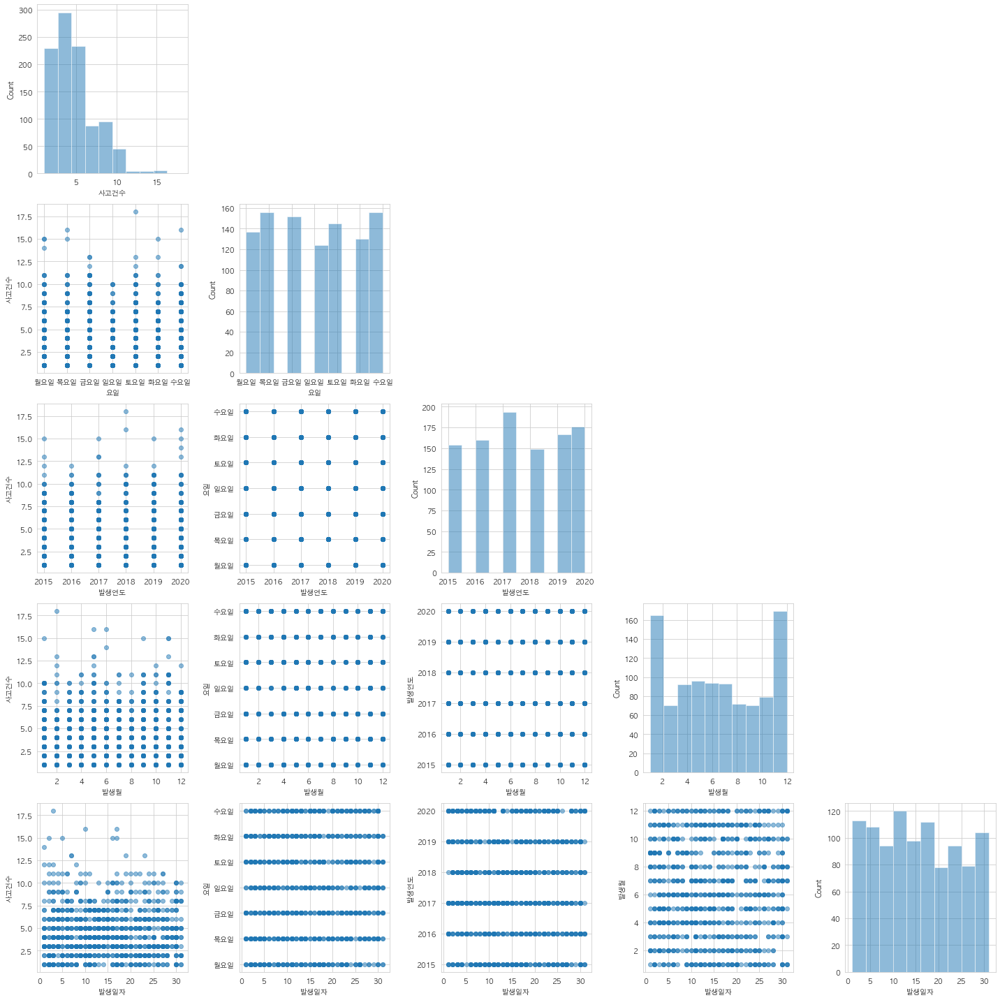

In [42]:
import matplotlib.pyplot as plt
plt.rcParams['font.family'] = 'AppleGothic'
from mlxtend.plotting import scatterplotmatrix
import random

cols = list(result_df.columns)
value = random.sample(range(result_df.index.size), 1000)
scatterplotmatrix(result_df[cols].values[value], figsize=(20, 20),
                  names=cols, alpha=0.5)
plt.tight_layout()
plt.show()

In [43]:
df_seoul.columns

Index(['사고번호', '사고일시', '요일', '시군구', '사고내용', '사망자수', '중상자수', '경상자수', '부상신고자수',
       '사고유형', '법규위반', '노면상태', '기상상태', '도로형태', '가해운전자 차종', '가해운전자 성별',
       '가해운전자 연령', '가해운전자 상해정도', '피해운전자 차종', '피해운전자 성별', '피해운전자 연령',
       '피해운전자 상해정도', '발생연도', '발생월', '발생일자', '발생시간'],
      dtype='object')

### 범주형 특성 라벨링
- 사고에 영향을 미치는 범주형 데이터인 발생시간, 요일, 노면상태, 기상상태, 도로형태를 라벨링


In [44]:
# sum을 구하기 위해 사고건수를 1로 지정
df_seoul['사고건수'] = 1

In [45]:
df_seoul['발생시간'] = df_seoul['발생시간'].astype('object')

In [46]:
df_seoul02 = df_seoul.copy()
for i in ['발생시간', '요일', '노면상태', '기상상태', '도로형태']:
    # mapping 변수를 이용해 사고건수 순으로 정렬 후 가장 높은 것부터 labeling함
    mapping = {label: idx for idx, label in enumerate(df_seoul.groupby(i).sum()['사고건수'].sort_values(ascending=False).index)}
    print(mapping)
    df_seoul02[i] = df_seoul[i].map(mapping)

{18: 0, 19: 1, 17: 2, 16: 3, 15: 4, 20: 5, 14: 6, 21: 7, 13: 8, 8: 9, 22: 10, 12: 11, 11: 12, 9: 13, 23: 14, 10: 15, 0: 16, 1: 17, 7: 18, 2: 19, 6: 20, 5: 21, 3: 22, 4: 23}
{'금요일': 0, '토요일': 1, '목요일': 2, '수요일': 3, '화요일': 4, '월요일': 5, '일요일': 6}
{'포장 - 건조': 0, '포장 - 젖음/습기': 1, '포장 - 습기': 2, '포장 - 기타': 3, '포장 - 서리/결빙': 4, '포장 - 적설': 5, '포장 - 결빙': 6, '비포장 - 건조': 7, '비포장 - 젖음/습기': 8, '비포장 - 기타': 9, '비포장 - 습기': 10, '포장 - 침수': 11, '포장 - 해빙': 12, '비포장 - 서리/결빙': 13, '비포장 - 적설': 14, '비포장 - 해빙': 15}
{'맑음': 0, '비': 1, '흐림': 2, '기타': 3, '눈': 4, '안개': 5}
{'단일로 - 기타': 0, '교차로 - 교차로안': 1, '교차로 - 교차로부근': 2, '기타 - 기타': 3, '교차로 - 교차로횡단보도내': 4, '단일로 - 횡단보도상': 5, '단일로 - 교량': 6, '단일로 - 횡단보도부근': 7, '단일로 - 지하차도(도로)내': 8, '단일로 - 터널': 9, '단일로 - 고가도로위': 10, '주차장 - 주차장': 11, '미분류 - 미분류': 12}


In [47]:
df_seoul02 # 이 데이터 프레임은 위 mapping 함수를 봐야 함

,사고번호,사고일시,요일,시군구,사고내용,사망자수,중상자수,경상자수,부상신고자수,사고유형,...,가해운전자 상해정도,피해운전자 차종,피해운전자 성별,피해운전자 연령,피해운전자 상해정도,발생연도,발생월,발생일자,발생시간,사고건수
0,2015010100100001,2015-01-01 00:00:00,2,은평구,중상사고,0,1,0,0,차대사람 - 길가장자리구역통행중,...,상해없음,보행자,남,48세,중상,2015,1,1,16,1
1,2015010100100002,2015-01-01 00:00:00,2,은평구,중상사고,0,1,0,0,차대사람 - 보도통행중,...,상해없음,보행자,남,59세,중상,2015,1,1,16,1
2,2015010100100003,2015-01-01 00:00:00,2,동대문구,중상사고,0,1,0,0,차대사람 - 기타,...,상해없음,보행자,남,52세,중상,2015,1,1,16,1
3,2015010100100004,2015-01-01 00:00:00,2,송파구,경상사고,0,0,1,0,차대차 - 추돌 - 진행중,...,상해없음,승용,여,57세,경상,2015,1,1,16,1
4,2015010100100039,2015-01-01 01:00:00,2,중구,경상사고,0,0,1,0,차대차 - 측면직각충돌,...,상해없음,승용,남,62세,상해없음,2015,1,1,17,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
233604,2020123100100571,2020-12-31 22:00:00,2,동대문구,경상사고,0,0,1,0,차대차 - 기타,...,상해없음,자전거,남,41세,경상,2020,12,31,10,1
233605,2020123100100572,2020-12-31 22:00:00,2,강동구,경상사고,0,0,1,0,차대차 - 정면충돌,...,상해없음,승용,남,21세,경상,2020,12,31,10,1
233606,2020123100100591,2020-12-31 23:00:00,2,강남구,경상사고,0,0,2,0,차대차 - 추돌,...,기타불명,승용,남,29세,경상,2020,12,31,14,1
233607,2020123100100592,2020-12-31 23:00:00,2,송파구,중상사고,0,1,0,0,차대차 - 측면충돌,...,상해없음,이륜,남,22세,중상,2020,12,31,14,1


## 학습을 위한 데이터셋으로 만들기
### 예측하고자 하는 것
- 사고 건수 예측. 발생 일시, 장소에서 일어나는 사고들의 건수를 예측하기

### 처리해야할 일
- 실제 사고에 영향을 미칠 수 있는 피쳐들만 남기기
- 일시, 시군구로 나눠서 몇건이 발생하는지
- 당시 노면상태, 기상상태, 도로형태를 최빈값으로 지정하기...?

In [48]:
# 피쳐 선택
feature_names = ['발생시간', '요일', '발생월', '발생일자', '노면상태', '기상상태', '도로형태']

In [49]:
df_for_learn = pd.DataFrame()

In [50]:
df_seoul02['발생일'] = df_seoul02['사고일시'].dt.to_period('D')
df_seoul02['발생일']

0         2015-01-01
1         2015-01-01
2         2015-01-01
3         2015-01-01
4         2015-01-01
             ...    
233604    2020-12-31
233605    2020-12-31
233606    2020-12-31
233607    2020-12-31
233608    2020-12-31
Name: 발생일, Length: 233609, dtype: period[D]

In [51]:
df_seoul02

,사고번호,사고일시,요일,시군구,사고내용,사망자수,중상자수,경상자수,부상신고자수,사고유형,...,피해운전자 차종,피해운전자 성별,피해운전자 연령,피해운전자 상해정도,발생연도,발생월,발생일자,발생시간,사고건수,발생일
0,2015010100100001,2015-01-01 00:00:00,2,은평구,중상사고,0,1,0,0,차대사람 - 길가장자리구역통행중,...,보행자,남,48세,중상,2015,1,1,16,1,2015-01-01
1,2015010100100002,2015-01-01 00:00:00,2,은평구,중상사고,0,1,0,0,차대사람 - 보도통행중,...,보행자,남,59세,중상,2015,1,1,16,1,2015-01-01
2,2015010100100003,2015-01-01 00:00:00,2,동대문구,중상사고,0,1,0,0,차대사람 - 기타,...,보행자,남,52세,중상,2015,1,1,16,1,2015-01-01
3,2015010100100004,2015-01-01 00:00:00,2,송파구,경상사고,0,0,1,0,차대차 - 추돌 - 진행중,...,승용,여,57세,경상,2015,1,1,16,1,2015-01-01
4,2015010100100039,2015-01-01 01:00:00,2,중구,경상사고,0,0,1,0,차대차 - 측면직각충돌,...,승용,남,62세,상해없음,2015,1,1,17,1,2015-01-01
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
233604,2020123100100571,2020-12-31 22:00:00,2,동대문구,경상사고,0,0,1,0,차대차 - 기타,...,자전거,남,41세,경상,2020,12,31,10,1,2020-12-31
233605,2020123100100572,2020-12-31 22:00:00,2,강동구,경상사고,0,0,1,0,차대차 - 정면충돌,...,승용,남,21세,경상,2020,12,31,10,1,2020-12-31
233606,2020123100100591,2020-12-31 23:00:00,2,강남구,경상사고,0,0,2,0,차대차 - 추돌,...,승용,남,29세,경상,2020,12,31,14,1,2020-12-31
233607,2020123100100592,2020-12-31 23:00:00,2,송파구,중상사고,0,1,0,0,차대차 - 측면충돌,...,이륜,남,22세,중상,2020,12,31,14,1,2020-12-31


In [52]:
df_seoul02.groupby(['발생일', '시군구'])['사고건수'].sum()

발생일         시군구
2015-01-01  강남구    7
            강동구    1
            강북구    3
            강서구    3
            관악구    4
                  ..
2020-12-31  용산구    1
            은평구    3
            종로구    6
            중구     3
            중랑구    3
Name: 사고건수, Length: 52815, dtype: int64

In [53]:
# 데이터 프레임 만들어서 for문으로 다 담기
def reconstruct_data(df):
    for i in range(len(result_df)):
        df = df.append(df_seoul[df_seoul['사고일시'] == result_df.index[i]].mode().loc[0, ['사고일시', '발생월', '발생일자', '발생시간', '노면상태', '기상상태', '도로형태']])
    return df
# 팬시 인덱싱으로 df[df[발생일]==0101&[시군구==강남구] 의 형식으로 아예 새로운 데이터 프레임을 만들기
# 거기에다가 mode()메서드를 이용해 최빈값 꺼내기

In [54]:
df_for_learn = pd.DataFrame()
df_for_learn = reconstruct_data(df_for_learn)

/var/folders/wv/bnpq1s_d23qg2x2m69xg48gc0000gn/T/ipykernel_21157/2145513388.py:4: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(df_seoul[df_seoul['사고일시'] == result_df.index[i]].mode().loc[0, ['사고일시', '발생월', '발생일자', '발생시간', '노면상태', '기상상태', '도로형태']])
/var/folders/wv/bnpq1s_d23qg2x2m69xg48gc0000gn/T/ipykernel_21157/2145513388.py:4: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(df_seoul[df_seoul['사고일시'] == result_df.index[i]].mode().loc[0, ['사고일시', '발생월', '발생일자', '발생시간', '노면상태', '기상상태', '도로형태']])
/var/folders/wv/bnpq1s_d23qg2x2m69xg48gc0000gn/T/ipykernel_21157/2145513388.py:4: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(df_seoul[df_seoul['사고일시'] == result_df.index[i]].mode().loc[0,

In [55]:
df_for_learn

,사고일시,발생월,발생일자,발생시간,노면상태,기상상태,도로형태
0,2015-01-01 00:00:00,1.0,1.0,0,포장 - 건조,맑음,단일로 - 기타
0,2015-01-01 01:00:00,1.0,1.0,1,포장 - 건조,맑음,단일로 - 기타
0,2015-01-01 02:00:00,1.0,1.0,2,포장 - 건조,맑음,교차로 - 교차로부근
0,2015-01-01 03:00:00,1.0,1.0,3,포장 - 건조,맑음,단일로 - 기타
0,2015-01-01 04:00:00,1.0,1.0,4,포장 - 건조,맑음,교차로 - 교차로부근
...,...,...,...,...,...,...,...
0,2020-12-31 19:00:00,12.0,31.0,19,포장 - 건조,맑음,단일로 - 기타
0,2020-12-31 20:00:00,12.0,31.0,20,포장 - 건조,맑음,교차로 - 교차로안
0,2020-12-31 21:00:00,12.0,31.0,21,포장 - 건조,맑음,단일로 - 기타
0,2020-12-31 22:00:00,12.0,31.0,22,포장 - 건조,맑음,교차로 - 교차로부근


In [56]:
# 사고 건수의 합을 나타내고 있는 result_df와 병합
df_for_learn_after_merge = df_for_learn.merge(result_df, how='outer', on='사고일시')

In [57]:
# 순서대로 다시 재정렬
df_for_learn_after_merge = df_for_learn_after_merge[['사고일시', '발생월_x', '발생일자_x', '발생시간', '노면상태', '기상상태', '도로형태', '요일', '발생연도', '사고건수']]

In [58]:
df_for_learn_after_merge.rename(columns={'발생월_x': '발생월', '발생일자_x': '발생일'}, inplace=True)

In [59]:
df_for_learn_after_merge

,사고일시,발생월,발생일,발생시간,노면상태,기상상태,도로형태,요일,발생연도,사고건수
0,2015-01-01 00:00:00,1.0,1.0,0,포장 - 건조,맑음,단일로 - 기타,목요일,2015,4
1,2015-01-01 01:00:00,1.0,1.0,1,포장 - 건조,맑음,단일로 - 기타,목요일,2015,6
2,2015-01-01 02:00:00,1.0,1.0,2,포장 - 건조,맑음,교차로 - 교차로부근,목요일,2015,3
3,2015-01-01 03:00:00,1.0,1.0,3,포장 - 건조,맑음,단일로 - 기타,목요일,2015,3
4,2015-01-01 04:00:00,1.0,1.0,4,포장 - 건조,맑음,교차로 - 교차로부근,목요일,2015,3
...,...,...,...,...,...,...,...,...,...,...
50122,2020-12-31 19:00:00,12.0,31.0,19,포장 - 건조,맑음,단일로 - 기타,목요일,2020,12
50123,2020-12-31 20:00:00,12.0,31.0,20,포장 - 건조,맑음,교차로 - 교차로안,목요일,2020,3
50124,2020-12-31 21:00:00,12.0,31.0,21,포장 - 건조,맑음,단일로 - 기타,목요일,2020,5
50125,2020-12-31 22:00:00,12.0,31.0,22,포장 - 건조,맑음,교차로 - 교차로부근,목요일,2020,4


## 범주형 특성 라벨링

In [60]:
df_for_learn_preprocecing = df_for_learn_after_merge.copy()
for i in ['노면상태', '기상상태', '도로형태', '요일']:
    mapping = {label: idx for idx, label in enumerate(df_seoul.groupby(i).sum()['사고건수'].sort_values(ascending=False).index)}
    print(mapping)
    df_for_learn_preprocecing[i] = df_for_learn_after_merge[i].map(mapping)

{'포장 - 건조': 0, '포장 - 젖음/습기': 1, '포장 - 습기': 2, '포장 - 기타': 3, '포장 - 서리/결빙': 4, '포장 - 적설': 5, '포장 - 결빙': 6, '비포장 - 건조': 7, '비포장 - 젖음/습기': 8, '비포장 - 기타': 9, '비포장 - 습기': 10, '포장 - 침수': 11, '포장 - 해빙': 12, '비포장 - 서리/결빙': 13, '비포장 - 적설': 14, '비포장 - 해빙': 15}
{'맑음': 0, '비': 1, '흐림': 2, '기타': 3, '눈': 4, '안개': 5}
{'단일로 - 기타': 0, '교차로 - 교차로안': 1, '교차로 - 교차로부근': 2, '기타 - 기타': 3, '교차로 - 교차로횡단보도내': 4, '단일로 - 횡단보도상': 5, '단일로 - 교량': 6, '단일로 - 횡단보도부근': 7, '단일로 - 지하차도(도로)내': 8, '단일로 - 터널': 9, '단일로 - 고가도로위': 10, '주차장 - 주차장': 11, '미분류 - 미분류': 12}
{'금요일': 0, '토요일': 1, '목요일': 2, '수요일': 3, '화요일': 4, '월요일': 5, '일요일': 6}


In [61]:
df_for_learn_preprocecing

,사고일시,발생월,발생일,발생시간,노면상태,기상상태,도로형태,요일,발생연도,사고건수
0,2015-01-01 00:00:00,1.0,1.0,0,0,0,0,2,2015,4
1,2015-01-01 01:00:00,1.0,1.0,1,0,0,0,2,2015,6
2,2015-01-01 02:00:00,1.0,1.0,2,0,0,2,2,2015,3
3,2015-01-01 03:00:00,1.0,1.0,3,0,0,0,2,2015,3
4,2015-01-01 04:00:00,1.0,1.0,4,0,0,2,2,2015,3
...,...,...,...,...,...,...,...,...,...,...
50122,2020-12-31 19:00:00,12.0,31.0,19,0,0,0,2,2020,12
50123,2020-12-31 20:00:00,12.0,31.0,20,0,0,1,2,2020,3
50124,2020-12-31 21:00:00,12.0,31.0,21,0,0,0,2,2020,5
50125,2020-12-31 22:00:00,12.0,31.0,22,0,0,2,2,2020,4


# 모델 구현

In [62]:
# 모델 import
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score
from sklearn.ensemble import RandomForestRegressor

In [63]:
# 훈련 / 테스트 데이터 split
# 발생연도 2015~ 2020년까지 6년간의 데이터 중, 2019부터 2년치를 테스트 데이터로, 그 이전 데이터는 트레인 데이터로 사용함
def split_data(data, feature_names):
    x_train = data[(data['발생연도']<2019)][feature_names]
    x_test = data[(data['발생연도']>=2019)][feature_names]
    y_train = data[(data['발생연도']<2019)]['사고건수']
    y_test = data[(data['발생연도']>=2019)]['사고건수']

    return x_train, x_test, y_train, y_test

- 랜덤포레스트 모델 생성 함수를 먼저 정의함
- 모델 평가 지표로 MSE, R^2, K-Fold
    - MSE : 평균제곱오차, 잔차의 제곱을 씌워 평균을 구한 값
    - KFold : k개의 검증세트를 만들어 검증
    - R2 score : 1 - 제곱오차항 / 전체제곱의 합 => 1에 가까울 수록 설명력이 좋다
    -

In [64]:
'''
def random_forest_fit():
    forest = RandomForestRegressor(n_estimators=100,
                                   criterion='mse',
                                   random_state=0,
                                   n_jobs=-1)
    forest.fit(x_train, y_train)
    y_train_pred = forest.predict(x_train)
    y_test_pred = forest.predict(x_test)

    print('훈련 데이터 MSE : %.3f, 테스트 데이터 MSE : %.3f' % mean_squared_error(y_train, y_train_pred), mean_squared_error(y_test, y_test_pred))
    print('훈련 데이터 R^2 : %.3f, 테스트 데이터 R^2 : %.3f' % r2_score(y_train,y_train_pred), r2_score(y_test, y_test_pred))

    plt.style.use('fivethirtyeight')
    plt.figure(figsize=(30, 10))
    plt.plot(y_test[:300], label='real')
    plt.plot(y_test_pred[:300], label='pred')
    plt.legend()
    plt.show()

    k_fold = KFold(n_splits=5, shuffle=True, random_state=0)

    scores = cross_val_score(estimator=forest,
                             X=x_train,
                             y=y_train,
                             cv=10,
                             n_jobs=-1)
    print('cross val score : %.3f' % scores)
    print('cross val 정확도 : %.3f +/- %.3f' % np.mean(scores), np.std(scores))
    '''

"\ndef random_forest_fit():\n    forest = RandomForestRegressor(n_estimators=100,\n                                   criterion='mse',\n                                   random_state=0,\n                                   n_jobs=-1)\n    forest.fit(x_train, y_train)\n    y_train_pred = forest.predict(x_train)\n    y_test_pred = forest.predict(x_test)\n\n    print('훈련 데이터 MSE : %.3f, 테스트 데이터 MSE : %.3f' % mean_squared_error(y_train, y_train_pred), mean_squared_error(y_test, y_test_pred))\n    print('훈련 데이터 R^2 : %.3f, 테스트 데이터 R^2 : %.3f' % r2_score(y_train,y_train_pred), r2_score(y_test, y_test_pred))\n\n    plt.style.use('fivethirtyeight')\n    plt.figure(figsize=(30, 10))\n    plt.plot(y_test[:300], label='real')\n    plt.plot(y_test_pred[:300], label='pred')\n    plt.legend()\n    plt.show()\n\n    k_fold = KFold(n_splits=5, shuffle=True, random_state=0)\n\n    scores = cross_val_score(estimator=forest,\n                             X=x_train,\n                             y=y_train

### 모델 구현


In [65]:
df_for_learn_preprocecing

,사고일시,발생월,발생일,발생시간,노면상태,기상상태,도로형태,요일,발생연도,사고건수
0,2015-01-01 00:00:00,1.0,1.0,0,0,0,0,2,2015,4
1,2015-01-01 01:00:00,1.0,1.0,1,0,0,0,2,2015,6
2,2015-01-01 02:00:00,1.0,1.0,2,0,0,2,2,2015,3
3,2015-01-01 03:00:00,1.0,1.0,3,0,0,0,2,2015,3
4,2015-01-01 04:00:00,1.0,1.0,4,0,0,2,2,2015,3
...,...,...,...,...,...,...,...,...,...,...
50122,2020-12-31 19:00:00,12.0,31.0,19,0,0,0,2,2020,12
50123,2020-12-31 20:00:00,12.0,31.0,20,0,0,1,2,2020,3
50124,2020-12-31 21:00:00,12.0,31.0,21,0,0,0,2,2020,5
50125,2020-12-31 22:00:00,12.0,31.0,22,0,0,2,2,2020,4


In [66]:
feature_names = ['발생월', '발생일', '발생시간', '노면상태', '기상상태', '도로형태', '요일', '발생연도']

In [67]:
x_train, x_test, y_train, y_test = split_data(df_for_learn_preprocecing, feature_names)

In [68]:
x_train.shape, y_train.shape, x_test.shape, y_test.shape

((33714, 8), (33714,), (16413, 8), (16413,))

In [69]:
forest = RandomForestRegressor(n_estimators=100,
                               criterion='mse',
                               random_state=0,
                               n_jobs=-1)
forest.fit(x_train, y_train)

/opt/homebrew/Caskroom/miniforge/base/envs/seongminenv/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:400: FutureWarning: Criterion 'mse' was deprecated in v1.0 and will be removed in version 1.2. Use `criterion='squared_error'` which is equivalent.
  warn(


RandomForestRegressor(criterion='mse', n_jobs=-1, random_state=0)

In [70]:
# 예측
y_train_pred = forest.predict(x_train)
y_test_pred = forest.predict(x_test)

In [71]:
mean_squared_error(y_test, y_test_pred)

5.554194516541766

In [72]:
print(y_test.reset_index(drop=True))
print(y_test_pred)

0         3
1         5
2         5
3         2
4         4
         ..
16408    12
16409     3
16410     5
16411     4
16412     3
Name: 사고건수, Length: 16413, dtype: int64
[1.62 3.71 4.1  ... 6.87 4.83 7.98]


훈련 데이터 MSE : 0.731, 테스트 데이터 MSE : 5.554
훈련 데이터 R^2 : 0.897, 테스트 데이터 R^2 : 0.276


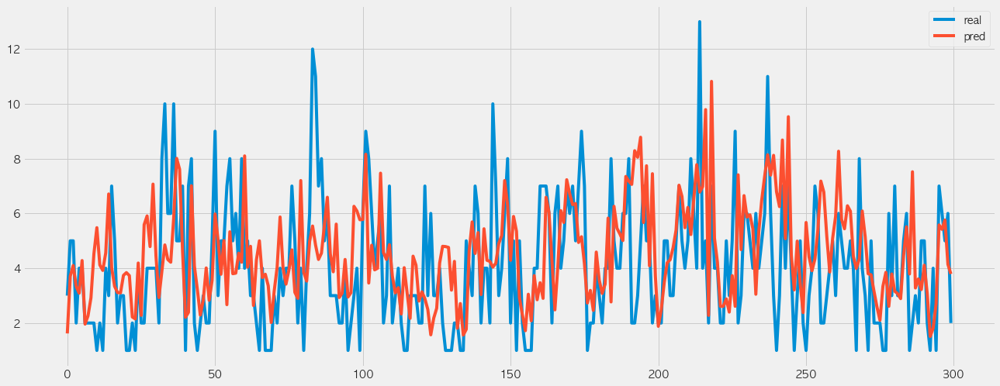

cross val score : [0.21069787 0.22985089 0.25895311 0.27172586 0.24407841 0.21935078
 0.24059664 0.20161517 0.25797795 0.21580688]
cross val 정확도 : 0.235 +/- 0.022


In [73]:
# 예측성능비교
# print('훈련 데이터 MSE : %0.3f, 테스트 데이터 MSE : %0.3f' % mean_squared_error(y_train, y_train_pred), mean_squared_error(y_test, y_test_pred))
# print('훈련 데이터 R^2 : %0.3f, 테스트 데이터 R^2 : %0.3f' % r2_score(y_train,y_train_pred), r2_score(y_test, y_test_pred))
print(f'훈련 데이터 MSE : {mean_squared_error(y_train, y_train_pred):.3f}, 테스트 데이터 MSE : {mean_squared_error(y_test, y_test_pred):.3f}')
print(f'훈련 데이터 R^2 : {r2_score(y_train,y_train_pred):.3f}, 테스트 데이터 R^2 : {r2_score(y_test, y_test_pred):.3f}')

plt.style.use('fivethirtyeight')
plt.figure(figsize=(20, 8))
plt.plot(y_test.reset_index(drop=True)[:300], label='real')
plt.plot(y_test_pred[:300], label='pred')
plt.legend()
plt.show()

k_fold = KFold(n_splits=5, shuffle=True, random_state=0)

scores = cross_val_score(estimator=forest,
                         X=x_train,
                         y=y_train,
                         cv=10,
                         n_jobs=-1)
print(f'cross val score : {scores}')
print(f'cross val 정확도 : {np.mean(scores):.3f} +/- {np.std(scores):.3f}')

[0.14997503 0.23816548 0.29428058 0.02408531 0.01575774 0.06240675
 0.12862223 0.08670688]


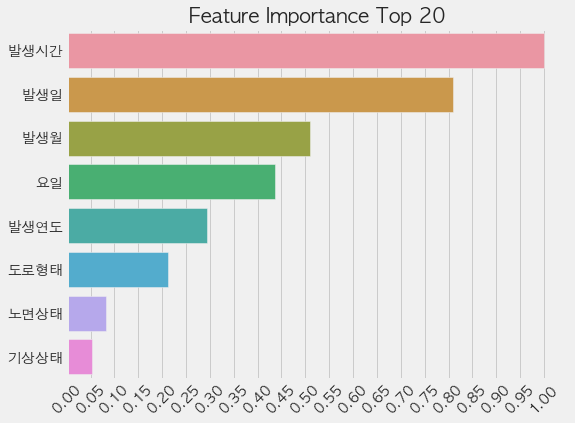

In [74]:
from preprocessing_data import f9_gbm_feature_importance
f9_gbm_feature_importance(forest, x_train)

# 모델 처리과정을 함수로 만들어 다른 피쳐들로 돌려보기
- 과적합 방지를 웨해 max_depth 파라미터 사용

In [75]:
# 위에서 사용한 피쳐들을 기본 인수로 사용하고 dataframe도 기본 인수로 사용함
def random_forest_fit(feature_names=['발생월', '발생일', '발생시간', '노면상태', '기상상태', '도로형태', '요일', '발생연도'], DataFrame=df_for_learn_preprocecing):
    print(f'사용가능 피쳐 : {list(df_for_learn_preprocecing.columns[:-1])}')
    print(f'입력 피쳐 : {feature_names}')
    x_train, x_test, y_train, y_test = split_data(DataFrame, feature_names)
    print(f'x_train shape : {x_train.shape} / y_train shape : {y_train.shape} / x_test shape : {x_test.shape} / y_test shape : {y_test.shape}')
    forest = RandomForestRegressor(n_estimators=100,
                                   criterion='mse',
                                   random_state=0,
                                   max_depth=8,
                                   n_jobs=-1)
    forest.fit(x_train, y_train)
    y_train_pred = forest.predict(x_train)
    y_test_pred = forest.predict(x_test)
    print(f'훈련 데이터 MSE : {mean_squared_error(y_train, y_train_pred):.3f}, 테스트 데이터 MSE : {mean_squared_error(y_test, y_test_pred):.3f}')
    print(f'훈련 데이터 R^2 : {r2_score(y_train,y_train_pred):.3f}, 테스트 데이터 R^2 : {r2_score(y_test, y_test_pred):.3f}')

    plt.style.use('fivethirtyeight')
    plt.figure(figsize=(20, 8))
    plt.plot(y_test.reset_index(drop=True)[:300], label='real')
    plt.plot(y_test_pred[:300], label='pred')
    plt.legend()
    plt.show()

    k_fold = KFold(n_splits=5, shuffle=True, random_state=0)

    scores = cross_val_score(estimator=forest,
                             X=x_train,
                             y=y_train,
                             cv=10,
                             n_jobs=-1)
    print(f'cross val score : {scores}')
    print(f'cross val 정확도 : {np.mean(scores):.3f} +/- {np.std(scores):.3f}')
    from preprocessing_data import f9_gbm_feature_importance
    f9_gbm_feature_importance(forest, x_train)
    return x_train, x_test, y_train, y_test, y_train_pred, y_test_pred

사용가능 피쳐 : ['사고일시', '발생월', '발생일', '발생시간', '노면상태', '기상상태', '도로형태', '요일', '발생연도']
입력 피쳐 : ['발생월', '발생일', '발생시간', '노면상태', '기상상태', '도로형태', '요일', '발생연도']
x_train shape : (33714, 8) / y_train shape : (33714,) / x_test shape : (16413, 8) / y_test shape : (16413,)


/opt/homebrew/Caskroom/miniforge/base/envs/seongminenv/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:400: FutureWarning: Criterion 'mse' was deprecated in v1.0 and will be removed in version 1.2. Use `criterion='squared_error'` which is equivalent.
  warn(


훈련 데이터 MSE : 4.680, 테스트 데이터 MSE : 5.079
훈련 데이터 R^2 : 0.338, 테스트 데이터 R^2 : 0.338


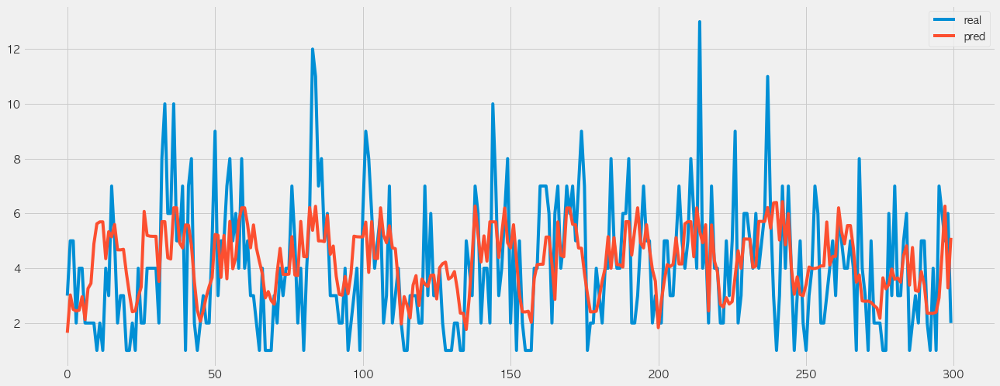

cross val score : [0.28415201 0.29159029 0.30221333 0.32706475 0.30611495 0.28004199
 0.30724219 0.25448443 0.31908514 0.31910648]
cross val 정확도 : 0.299 +/- 0.021
[0.0399861  0.02407573 0.57218437 0.04614162 0.01515156 0.14688542
 0.14446937 0.01110584]


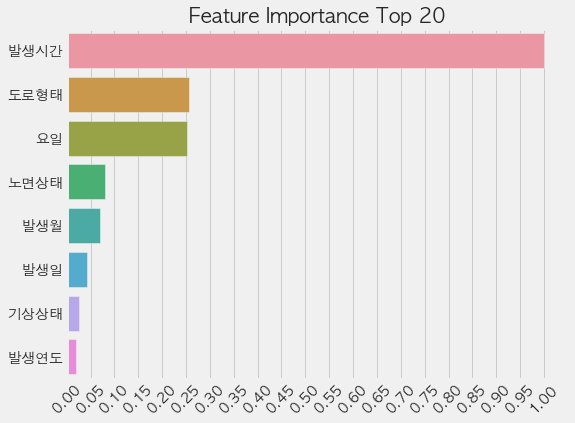

In [76]:
x_train, x_test, y_train, y_test, y_train_pred, y_test_pred = random_forest_fit()

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


평균 오차율은 62.29% 입니다


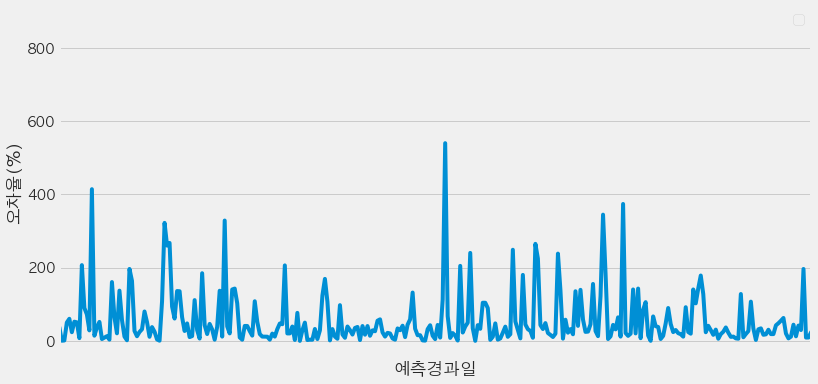

In [77]:
# 오차율 구하기
error_percentage=np.abs((y_test-y_test_pred)/y_test)*100
avg_error_percentage= np.average(error_percentage)

plt.figure(figsize=(12, 6))
plt.xlabel('예측경과일')
plt.ylabel('오차율(%)')
plt.xticks(np.arange(0,len(y_test),30))
plt.xlim(33800, 34100)
plt.plot(error_percentage)
print(f'평균 오차율은 {avg_error_percentage:.2f}% 입니다')
plt.grid()
plt.legend(loc='best')
plt.grid()
plt.show()

In [78]:
y_test

33714     3
33715     5
33716     5
33717     2
33718     4
         ..
50122    12
50123     3
50124     5
50125     4
50126     3
Name: 사고건수, Length: 16413, dtype: int64

# 다른 피쳐를 이용해 모델 구현

사용가능 피쳐 : ['사고일시', '발생월', '발생일', '발생시간', '노면상태', '기상상태', '도로형태', '요일', '발생연도']
입력 피쳐 : ['발생시간', '발생일', '발생월']
x_train shape : (33714, 3) / y_train shape : (33714,) / x_test shape : (16413, 3) / y_test shape : (16413,)


/opt/homebrew/Caskroom/miniforge/base/envs/seongminenv/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:400: FutureWarning: Criterion 'mse' was deprecated in v1.0 and will be removed in version 1.2. Use `criterion='squared_error'` which is equivalent.
  warn(


훈련 데이터 MSE : 5.442, 테스트 데이터 MSE : 5.806
훈련 데이터 R^2 : 0.230, 테스트 데이터 R^2 : 0.243


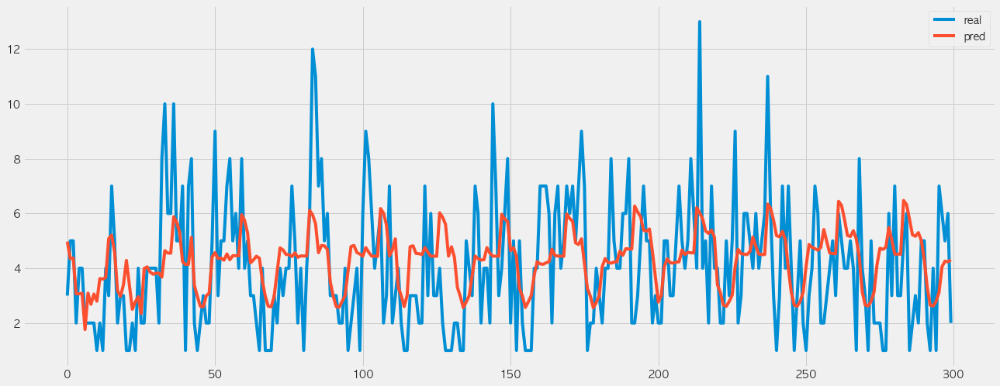

cross val score : [0.17291958 0.17739749 0.18060118 0.20510221 0.20730227 0.16932125
 0.2031224  0.15030803 0.21124633 0.21018778]
cross val 정확도 : 0.189 +/- 0.020
[0.81848962 0.08245933 0.09905105]


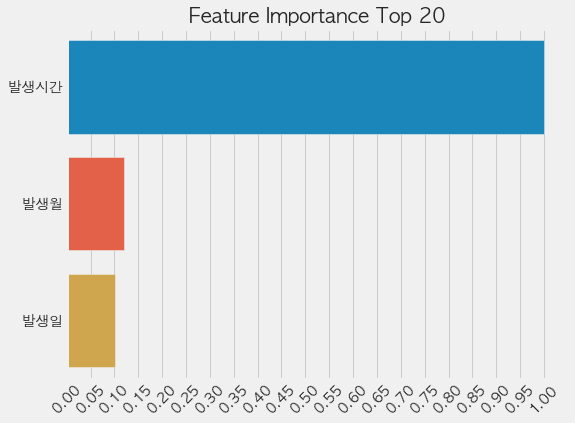

(       발생시간   발생일   발생월
 0         0   1.0   1.0
 1         1   1.0   1.0
 2         2   1.0   1.0
 3         3   1.0   1.0
 4         4   1.0   1.0
 ...     ...   ...   ...
 33709    19  31.0  12.0
 33710    20  31.0  12.0
 33711    21  31.0  12.0
 33712    22  31.0  12.0
 33713    23  31.0  12.0
 
 [33714 rows x 3 columns],
        발생시간   발생일   발생월
 33714     0   1.0   1.0
 33715     1   1.0   1.0
 33716     2   1.0   1.0
 33717     4   1.0   1.0
 33718     5   1.0   1.0
 ...     ...   ...   ...
 50122    19  31.0  12.0
 50123    20  31.0  12.0
 50124    21  31.0  12.0
 50125    22  31.0  12.0
 50126    23  31.0  12.0
 
 [16413 rows x 3 columns],
 0         4
 1         6
 2         3
 3         3
 4         3
          ..
 33709    12
 33710     8
 33711     7
 33712     5
 33713     9
 Name: 사고건수, Length: 33714, dtype: int64,
 33714     3
 33715     5
 33716     5
 33717     2
 33718     4
          ..
 50122    12
 50123     3
 50124     5
 50125     4
 50126     3
 Name: 사고건수, L

In [79]:
random_forest_fit(['발생시간', '발생일', '발생월'])

사용가능 피쳐 : ['사고일시', '발생월', '발생일', '발생시간', '노면상태', '기상상태', '도로형태', '요일', '발생연도']
입력 피쳐 : ['노면상태', '도로형태', '기상상태']
x_train shape : (33714, 3) / y_train shape : (33714,) / x_test shape : (16413, 3) / y_test shape : (16413,)
훈련 데이터 MSE : 6.369, 테스트 데이터 MSE : 6.916
훈련 데이터 R^2 : 0.099, 테스트 데이터 R^2 : 0.098


/opt/homebrew/Caskroom/miniforge/base/envs/seongminenv/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:400: FutureWarning: Criterion 'mse' was deprecated in v1.0 and will be removed in version 1.2. Use `criterion='squared_error'` which is equivalent.
  warn(


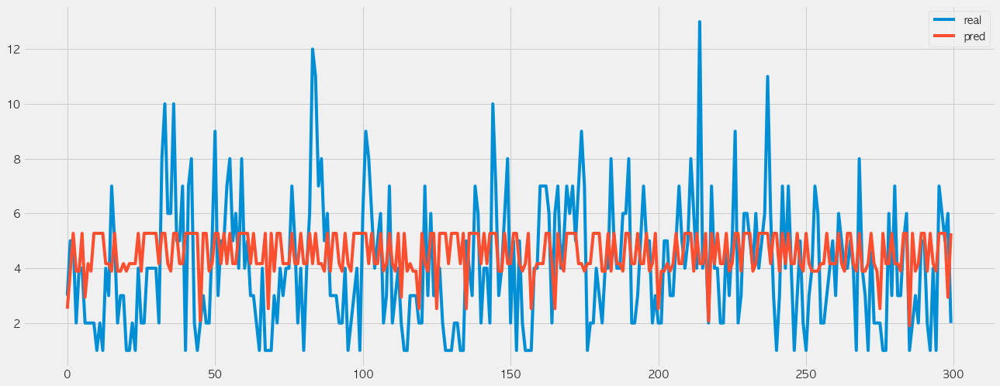

cross val score : [0.09104326 0.06861869 0.10963375 0.09911558 0.09655928 0.06322134
 0.0845687  0.08555657 0.08669486 0.09747481]
cross val 정확도 : 0.088 +/- 0.013
[0.07408255 0.72571496 0.2002025 ]


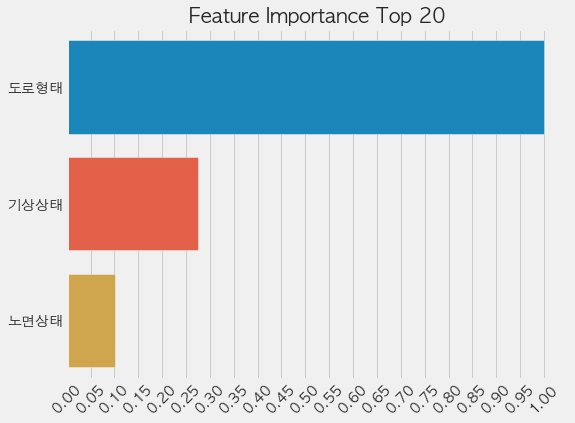

(       노면상태  도로형태  기상상태
 0         0     0     0
 1         0     0     0
 2         0     2     0
 3         0     0     0
 4         0     2     0
 ...     ...   ...   ...
 33709     0     0     0
 33710     0     0     0
 33711     0     0     0
 33712     0     0     0
 33713     0     0     0
 
 [33714 rows x 3 columns],
        노면상태  도로형태  기상상태
 33714     0     4     0
 33715     0     2     0
 33716     0     0     0
 33717     0     2     0
 33718     0     2     0
 ...     ...   ...   ...
 50122     0     0     0
 50123     0     1     0
 50124     0     0     0
 50125     0     2     0
 50126     0     0     0
 
 [16413 rows x 3 columns],
 0         4
 1         6
 2         3
 3         3
 4         3
          ..
 33709    12
 33710     8
 33711     7
 33712     5
 33713     9
 Name: 사고건수, Length: 33714, dtype: int64,
 33714     3
 33715     5
 33716     5
 33717     2
 33718     4
          ..
 50122    12
 50123     3
 50124     5
 50125     4
 50126     3
 Name: 사고건수, L

In [80]:
random_forest_fit(['노면상태', '도로형태', '기상상태'])

- 트리 그림그리기
- 참고 url https://teddylee777.github.io/visualization/Decision-Tree가-어떻게-분할했는지-시각화하기(graphviz)

# GridSearchCV 모듈을 사용하여 하이퍼 파라미터 튜닝

In [81]:
from sklearn.model_selection import GridSearchCV

def use_gridCV(feature_names=['발생월', '발생일', '발생시간', '노면상태', '기상상태', '도로형태', '요일', '발생연도'], DataFrame=df_for_learn_preprocecing):
    print(f'사용가능 피쳐 : {list(df_for_learn_preprocecing.columns[:-1])}')
    print(f'입력 피쳐 : {feature_names}')
    x_train, x_test, y_train, y_test = split_data(DataFrame, feature_names)
    print(f'x_train shape : {x_train.shape} / y_train shape : {y_train.shape} / x_test shape : {x_test.shape} / y_test shape : {y_test.shape}')

    # 랜덤 포레스트 튜닝
    x = df_for_learn_preprocecing[feature_names]

    params = {'n_estimators': [100],
              'max_depth': [8, 9, 10],
              'min_samples_leaf': [6, 7, 8],
              'min_samples_split': [8, 9, 10]}

    rfr = RandomForestRegressor()
    grid_cv = GridSearchCV(rfr, param_grid=params, cv=2, n_jobs=-1)
    grid_cv.fit(x_train, y_train)

    print(f'Best Params: {grid_cv.best_params_}')
    max_depth = grid_cv.best_params_['max_depth']
    min_samples_leaf = grid_cv.best_params_['min_samples_leaf']
    min_samples_split = grid_cv.best_params_['min_samples_split']
    n_estimators = grid_cv.best_params_['n_estimators']

    y_train_pred = grid_cv.predict(x_train)
    y_test_pred = grid_cv.predict(x_test)
    print(f'훈련 데이터 MSE : {mean_squared_error(y_train, y_train_pred):.3f}, 테스트 데이터 MSE : {mean_squared_error(y_test, y_test_pred):.3f}')
    print(f'훈련 데이터 R^2 : {r2_score(y_train,y_train_pred):.3f}, 테스트 데이터 R^2 : {r2_score(y_test, y_test_pred):.3f}')

    plt.style.use('fivethirtyeight')
    plt.figure(figsize=(20, 8))
    plt.plot(y_test.reset_index(drop=True)[:300], label='real')
    plt.plot(y_test_pred[:300], label='pred')
    plt.legend()
    plt.show()

    k_fold = KFold(n_splits=5, shuffle=True, random_state=0)

    scores = cross_val_score(estimator=forest,
                             X=x_train,
                             y=y_train,
                             cv=10,
                             n_jobs=-1)
    print(f'cross val score : {scores}')
    print(f'cross val 정확도 : {np.mean(scores):.3f} +/- {np.std(scores):.3f}')
    from preprocessing_data import f9_gbm_feature_importance
    f9_gbm_feature_importance(forest, x_train)

사용가능 피쳐 : ['사고일시', '발생월', '발생일', '발생시간', '노면상태', '기상상태', '도로형태', '요일', '발생연도']
입력 피쳐 : ['발생월', '발생일', '발생시간', '노면상태', '기상상태', '도로형태', '요일', '발생연도']
x_train shape : (33714, 8) / y_train shape : (33714,) / x_test shape : (16413, 8) / y_test shape : (16413,)
Best Params: {'max_depth': 10, 'min_samples_leaf': 8, 'min_samples_split': 8, 'n_estimators': 100}
훈련 데이터 MSE : 4.455, 테스트 데이터 MSE : 4.984
훈련 데이터 R^2 : 0.370, 테스트 데이터 R^2 : 0.350


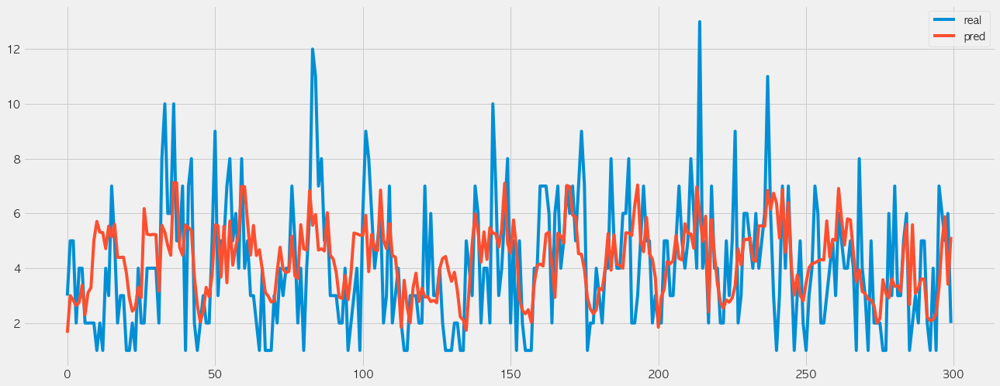

cross val score : [0.21069787 0.22985089 0.25895311 0.27172586 0.24407841 0.21935078
 0.24059664 0.20161517 0.25797795 0.21580688]
cross val 정확도 : 0.235 +/- 0.022
[0.14997503 0.23816548 0.29428058 0.02408531 0.01575774 0.06240675
 0.12862223 0.08670688]


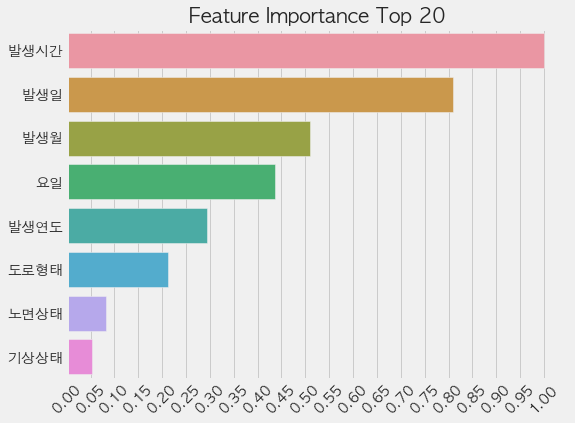

In [82]:
use_gridCV()

# 머신러닝 결과
-

# 결정트리 시각화
-> 보류

In [83]:
from sklearn.tree import export_graphviz
params = {'n_estimators': [100],
          'max_depth': [8, 9, 10],
          'min_samples_leaf': [6, 7, 8],
          'min_samples_split': [8, 9, 10]}

rfr = RandomForestRegressor()
grid_cv = GridSearchCV(rfr, param_grid=params, cv=2, n_jobs=-1)
grid_cv.fit(x_train, y_train)
estimator = grid_cv.estimators_[3]
export_graphviz(estimator, out_file='tree.dot',
                feature_names = df_for_learn_preprocecing.feature_names,
                class_names = df_for_learn_preprocecing.target_names,
                max_depth = 3, # 표현하고 싶은 최대 depth
                precision = 3, # 소수점 표기 자릿수
                filled = True, # class별 color 채우기
                rounded=True, # 박스의 모양을 둥글게
                )

AttributeError: 'GridSearchCV' object has no attribute 'estimators_'

In [ ]:
dir(grid_cv)